<a href="https://colab.research.google.com/github/ElenaIgn/Final-project.-Using-pigeon-recognition-as-an-example/blob/main/_ipynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Установка библиотек

In [ ]:
!pip install ultralytics
!pip install supervision
!pip install pytube

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML, clear_output
from tqdm.notebook import tqdm
from base64 import b64encode
from pytube import YouTube

from ultralytics import YOLO

from supervision import VideoInfo, VideoSink
from supervision import get_video_frames_generator
from supervision import Detections
from supervision import ByteTrack

In [ ]:
def download_video(link:str) -> None:
    youtubeObject = YouTube(link)
    youtubeObject = youtubeObject.streams.get_highest_resolution()
    try:
        youtubeObject.download()
    except:
        print("An error has occurred")
    print("Download is completed successfully")

In [ ]:
def show_video(path: str):
  path_compressed = path.removesuffix(".mp4") + "_compressed.mp4"
  os.system(f"ffmpeg -i {path} -vcodec libx264 {path_compressed}")

  with open(path_compressed, "rb") as video:
    mp4 = video.read()

  os.remove(path_compressed)

  data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
  return HTML(f"""
  <video width=800 controls>
        <source src="{data_url}" type="video/mp4">
  </video>
  """)

In [ ]:
model_small = YOLO("yolov8n.pt")
model_medium = YOLO("yolov8s.pt")
model_large = YOLO("yolov8m.pt")
tracker = ByteTrack()

In [ ]:

from google.colab import files
upload = files.upload()

In [ ]:
VIDEO_PATH = "golubi_1.mp4"

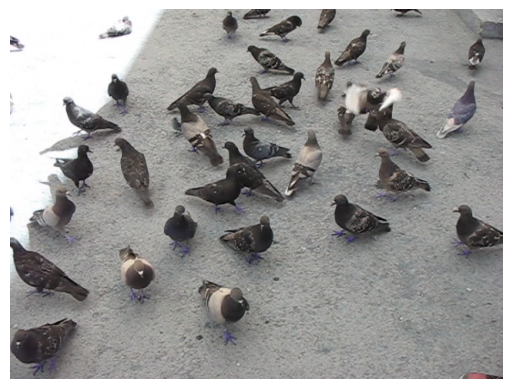

In [ ]:
gen = get_video_frames_generator(VIDEO_PATH)

for i, frame in enumerate(gen):
  if i > 5: break
  plt.imshow(frame)
  plt.axis("off")
  plt.show()
  clear_output(True)

In [ ]:
model_small = YOLO("yolov8n.pt")
gen = get_video_frames_generator(VIDEO_PATH)
frame = next(gen)

yolo_detections = model_small(frame)[0]
supervision_detections = Detections.from_ultralytics(yolo_detections)

In [ ]:
supervision_detections

In [ ]:
print(supervision_detections.tracker_id)

In [ ]:
tracker = ByteTrack()
supervision_detections = tracker.update_with_detections(supervision_detections)

supervision_detections.tracker_id

In [ ]:
from supervision import BoundingBoxAnnotator, LabelAnnotator, EllipseAnnotator

In [ ]:
bbox_annotator = BoundingBoxAnnotator()
label_annotator = LabelAnnotator()
ellipse_annotator = EllipseAnnotator()

annotators = [bbox_annotator, label_annotator, ellipse_annotator]

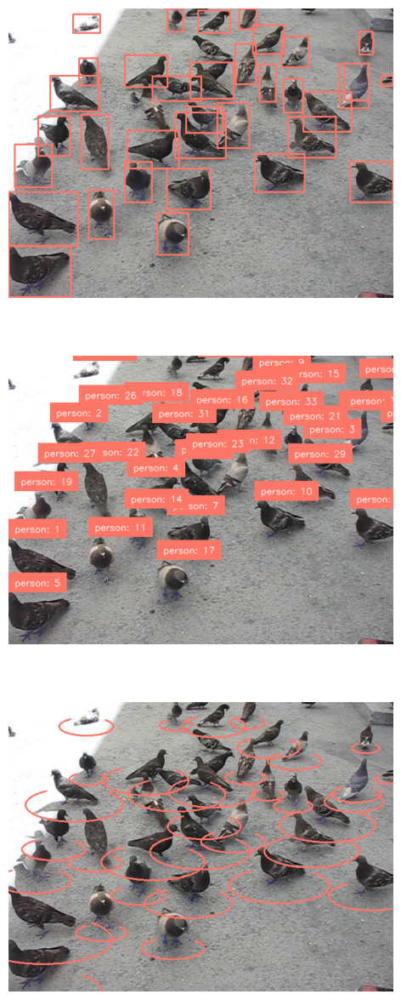

In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(15, 15))

for i, annotator in enumerate(annotators):
  if isinstance(annotator, LabelAnnotator):
    annotated_frame = annotator.annotate(
      scene=frame.copy(),
      detections=supervision_detections,
      labels=list(map(lambda x: f"person: {x}", supervision_detections.tracker_id))
    )
  else:
    annotated_frame = annotator.annotate(
      scene=frame.copy(),
      detections=supervision_detections,
    )
  axes[i].axis("off")
  axes[i].imshow(annotated_frame)

fig.show()

In [ ]:
from supervision import Color, ColorPalette, ColorLookup, Position

In [ ]:
bbox_annotator = BoundingBoxAnnotator(ColorPalette.DEFAULT, 4, ColorLookup.TRACK)
label_annotator = LabelAnnotator(ColorPalette.DEFAULT, Color.BLACK, text_position=Position.TOP_CENTER, color_lookup=ColorLookup.TRACK)
ellipse_annotator = EllipseAnnotator(ColorPalette.ROBOFLOW, 4, -30)

annotators = [bbox_annotator, label_annotator, ellipse_annotator]

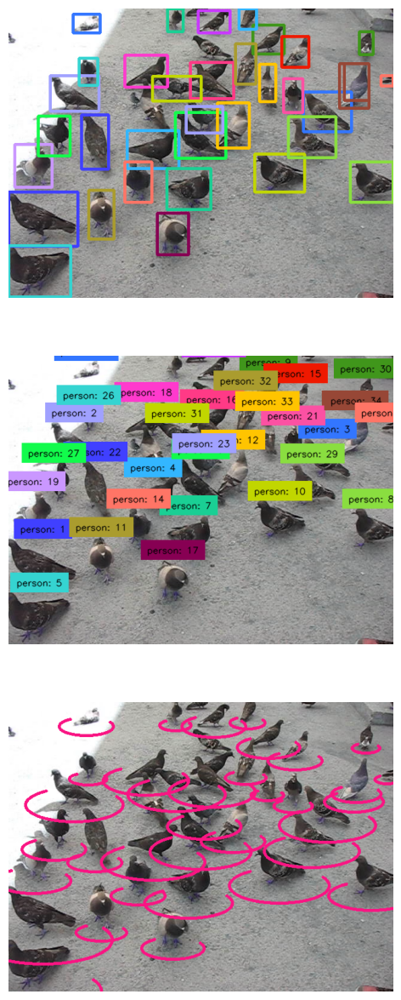

In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(15, 15))

for i, annotator in enumerate(annotators):
  if isinstance(annotator, LabelAnnotator):
    annotated_frame = annotator.annotate(
      scene=frame.copy(),
      detections=supervision_detections,
      labels=list(map(lambda x: f"person: {x}", supervision_detections.tracker_id))
    )
  else:
    annotated_frame = annotator.annotate(
      scene=frame.copy(),
      detections=supervision_detections,
    )
  axes[i].axis("off")
  axes[i].imshow(annotated_frame)

fig.show()

In [ ]:
show_video("golubi_1.mp4")

In [ ]:
from supervision import Color, ColorPalette, ColorLookup, Position

In [ ]:
bbox_annotator = BoundingBoxAnnotator(ColorPalette.DEFAULT, 4, ColorLookup.TRACK)
label_annotator = LabelAnnotator(ColorPalette.DEFAULT, Color.BLACK, text_position=Position.TOP_CENTER, color_lookup=ColorLookup.TRACK)
ellipse_annotator = EllipseAnnotator(ColorPalette.ROBOFLOW, 4, -30)

annotators = [bbox_annotator, label_annotator, ellipse_annotator]

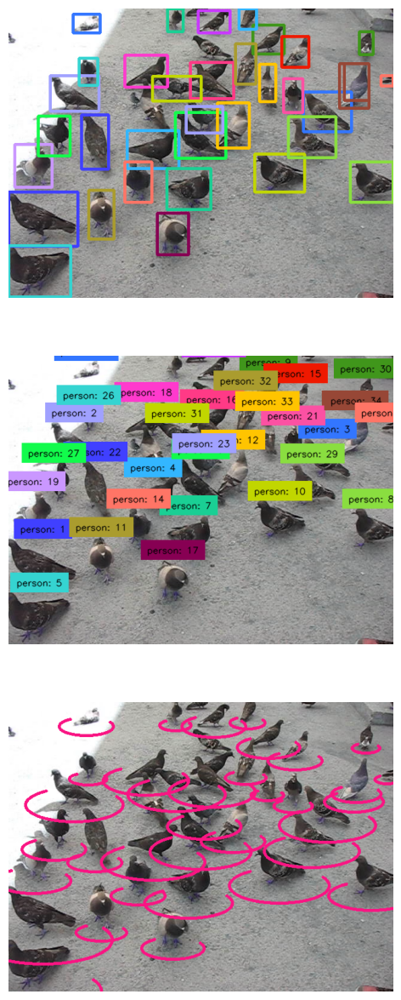

In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(15, 15))

for i, annotator in enumerate(annotators):
  if isinstance(annotator, LabelAnnotator):
    annotated_frame = annotator.annotate(
      scene=frame.copy(),
      detections=supervision_detections,
      labels=list(map(lambda x: f"person: {x}", supervision_detections.tracker_id))
    )
  else:
    annotated_frame = annotator.annotate(
      scene=frame.copy(),
      detections=supervision_detections,
    )
  axes[i].axis("off")
  axes[i].imshow(annotated_frame)

fig.show()

In [ ]:
detector = YOLO("yolov8n.pt")
tracker = ByteTrack()
annotator = TraceAnnotator()

In [ ]:
!pip install deep-sort-realtime==1.3.2
!pip install ultralytics==8.1.8

In [ ]:
from deep_sort_realtime.deepsort_tracker import DeepSort

In [ ]:
!git clone https://github.com/ifzhang/ByteTrack.git
!cd ByteTrack && pip install -r requirements.txt
!cd ByteTrack  && python setup.py develop
!pip install cython
!pip install 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
!pip install cython_bbox
!pip install onemetric
!pip install loguru
!pip install lap

In [ ]:
import os
import random
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image
from time import sleep
from base64 import b64encode
from tqdm.notebook import tqdm
from dataclasses import dataclass
from IPython.display import clear_output, HTML
from typing import Generator, Literal, Iterable, Any
from abc import ABC, abstractmethod

from ultralytics import YOLO
from ultralytics.engine.results import Results

from deep_sort_realtime.deepsort_tracker import DeepSort

from onemetric.cv.utils.iou import box_iou_batch

In [ ]:
VIDEO_PATH = "golubi_1.mp4"
COLORS = [tuple(random.randint(0, 255) for _ in range(3)) for _ in range(20)]

In [ ]:
def get_video_frame_generator(path: str) -> Generator[np.ndarray, None, None]:
  vid = cv2.VideoCapture(path)
  ret = True
  while ret:
    ret, frame = vid.read()
    yield frame
  vid.release()

In [ ]:
def extract_bboxes_for_deepsort(pred: Results):
  lt_wh = torch.cat((pred.boxes.xyxy[:, :2], pred.boxes.xywh[:, 2:]), 1).int().tolist()
  conf = pred.boxes.conf.tolist()
  cls = pred.boxes.cls.int().tolist()

  return list(zip(lt_wh, conf, cls))

In [ ]:
def draw_rectangles(frame: np.ndarray, ids: list, bboxes: list[list[int]]) -> np.ndarray:
  new_frame = frame.copy()
  for i, box in enumerate(bboxes):
    cv2.rectangle(new_frame, (box[0], box[1]), (box[2], box[3]), COLORS[ids[i]%10], 3)
    cv2.putText(new_frame, f"id:{ids[i]}", (box[0], box[1] - 6), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

  return new_frame

In [ ]:
def show_video(path: str):
  path_compressed = path.removesuffix(".mp4") + "_compressed.mp4"
  os.system(f"ffmpeg -i {path} -vcodec libx264 {path_compressed}")

  with open(path_compressed, "rb") as video:
    mp4 = video.read()

  os.remove(path_compressed)

  data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
  return HTML(f"""
  <video width=800 controls>
        <source src="{data_url}" type="video/mp4">
  </video>
  """)

In [ ]:
def extract_bboxes_for_bytetrack(pred: Results) -> np.ndarray:
  return np.hstack((pred.boxes.xyxy.cpu().detach().numpy(), pred.boxes.conf.cpu().detach().numpy()[..., None]))

In [ ]:
detector = YOLO("yolov8n.pt")
tracker = DeepSort(
    max_age=5, # Количество фреймов на которые будет сохраняться id объекта вышедшего из поля зрения
    n_init=2, # Количество фреймов чтобы инициализировать новый объект детекции собственным id
    nms_max_overlap=1.0, # Non-maximum suppression коэффициент. От 0 до 1. Чем выше, тем больше отдельных объектов
    max_cosine_distance=0.3,
    embedder="mobilenet",
    half=True,
)

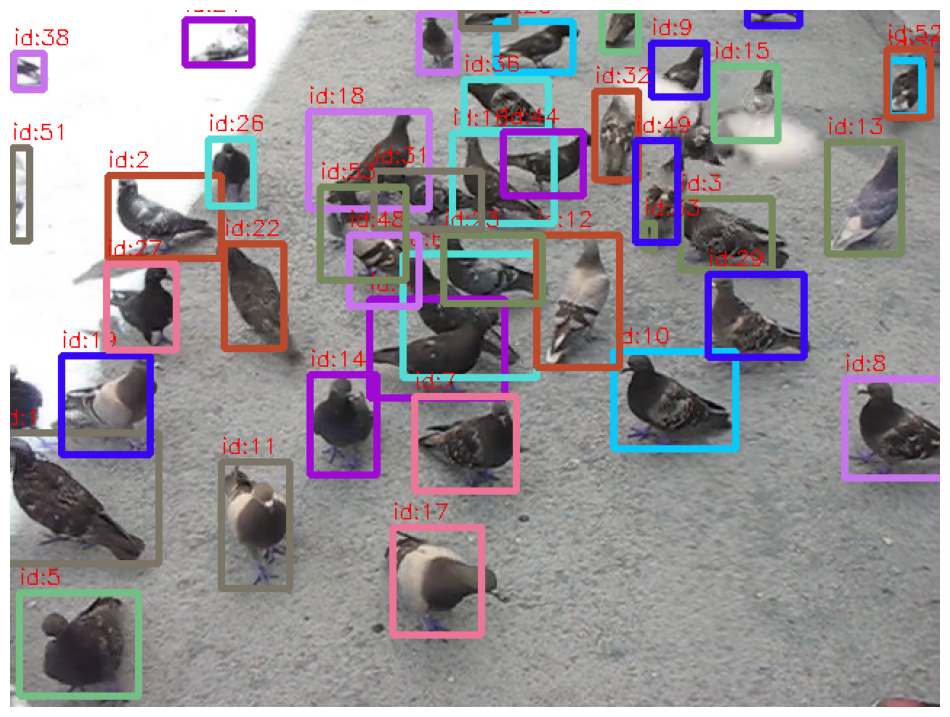

In [ ]:
n_iterations = 10

gen = get_video_frame_generator(VIDEO_PATH)

fig, ax = plt.subplots(figsize=(12, 10))
ax.set_axis_off()

for i, frame in enumerate(gen):
  if i == n_iterations: break
  pred = detector(frame, verbose=False)[0]
  bboxes = extract_bboxes_for_deepsort(pred)

  tracks = tracker.update_tracks(bboxes, frame=frame) # bboxes: ( [left,top,w,h], confidence, detection_class )
  ids = []
  ltrb_bboxes = []

  for track in tracks:
      if not track.is_confirmed():
          continue

      ids.append(int(track.track_id))
      ltrb_bboxes.append(track.to_ltrb().astype("int32").tolist())

  frame = draw_rectangles(frame, ids, ltrb_bboxes)
  ax.imshow(frame)
  display(fig)

  clear_output(wait=True)

In [ ]:
@dataclass(frozen=True)
class BYTETrackerArgs:
    track_thresh: float = 0.25
    track_buffer: int = 30
    match_thresh: float = 0.8
    aspect_ratio_thresh: float = 3.0
    min_box_area: float = 1.0
    mot20: bool = False

In [ ]:
show_video("/content/golubi_1.mp4")

In [ ]:
model = YOLO("yolov8n.pt")

res = model.track("golubi_1.mp4", conf=0.5, iou=0.4, save=True, stream=True)

In [ ]:
gen = get_video_frames_generator(VIDEO_PATH)
video_info = VideoInfo.from_video_path(VIDEO_PATH)

In [ ]:
with VideoSink(VIDEO_PATH_NEW, video_info) as sink:
  for frame in gen:
    yolo_detections = detector(frame, verbose=False)[0]
    detections = Detections.from_ultralytics(yolo_detections)
    detections = tracker.update_with_detections(detections)
    annotated_frame = annotator.annotate(
      scene=frame.copy(),
      detections=detections
    )

    sink.write_frame(annotated_frame)

In [ ]:
show_video("golubi_1.mp4")

In [ ]:
detector = YOLO("yolov8n.pt")
tracker = BYTETracker(BYTETrackerArgs())

In [ ]:
n_iterations = 10

gen = get_video_frame_generator(VIDEO_PATH)

fig, ax = plt.subplots(figsize=(12, 10))
ax.set_axis_off()

for i, frame in enumerate(gen):
  if i == n_iterations: break

  pred = detector(frame, verbose=False)[0]
  bboxes = extract_bboxes_for_bytetrack(pred)

  tracks = tracker.update(
      output_results=bboxes,
      img_info=frame.shape,
      img_size=frame.shape,
  )

  ids = match_pred_with_tracks(pred, tracks)
  ltrb_bboxes = bboxes[..., :-1].astype("int32").tolist()

  ltrb_bboxes, ids = list(zip(*filter(lambda x: x[1] is not None, zip(ltrb_bboxes, ids))))

  frame = draw_rectangles(frame, ids, ltrb_bboxes)
  ax.imshow(frame)
  display(fig)

  clear_output(wait=True)

In [ ]:
model_small = YOLO("yolov8n.pt")
tracker = ByteTrack()
annotator = TraceAnnotator()

In [ ]:
gen = get_video_frames_generator(VIDEO_PATH)
video_info = VideoInfo.from_video_path(VIDEO_PATH)

In [ ]:
with VideoSink(VIDEO_PATH, video_info) as sink:
  for frame in gen:
    yolo_detections = model_small(frame, verbose=False)[0]
    detections = Detections.from_ultralytics(yolo_detections)
    detections = tracker.update_with_detections(detections)
    annotated_frame = annotator.annotate(
      scene=frame.copy(),
      detections=detections
    )

    sink.write_frame(annotated_frame)

In [ ]:
show_video(VIDEO_PATH)